Con el árbol de decisión, el hecho de limitar la información de entrada no influye en el resultado. Ahora que ya hemos determinado cuál es el algoritmo de predicción más adecuado para el tipo de datos que estamos tratando, vamos a dar un  paso más: crearemos una función que haga una predicción de cada uno de los fotogramas e intercalaremos los resultados con las imágenes del GIF original para darle más definición.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn import linear_model
from sklearn import tree
from sklearn import svm
import os
import cv2
import cv
from PIL import Image
from IPython.core.display import Image as Imag

In [2]:
def prediccion (xx):
    data = []
    for i in range(24):
        if i != xx:
            imagen = cv2.imread("Anger/{}.jpg".format(i)) 
            img = cv2.cvtColor(imagen,cv2.COLOR_BGR2GRAY)  
            data.append(img.flatten()) 
    data = np.array(data)
    pixeles = [] 
    cont = 0
    obj  = xx
    for i in range(data.shape[1]): 

        if i%13744 == 0:  
            print(cont)
            cont+=1

        X = np.array(list(range(0,obj))+list(range(obj+1,24))).reshape(-1, 1) 
        y = data[:,i]   
        regr = tree.DecisionTreeRegressor()
        regr.fit(X, y)
        val = regr.predict(np.array([[obj]]))  
        pixeles.append(val)
    target = np.array(pixeles).reshape(276, 498)
    return target

In [3]:
resultados = []
for i in range(24):
    imagen = prediccion(i)
    resultados.append(imagen)

0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10
0
1
2
3
4
5
6
7
8
9
10


Visualizamos todos los fotogramas, originales y copias, y los añadimos a una lista ("fotogramas") intercalados. 

0


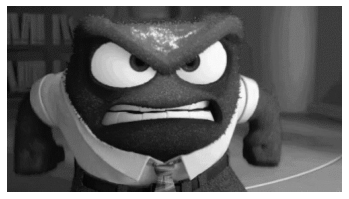

0bis


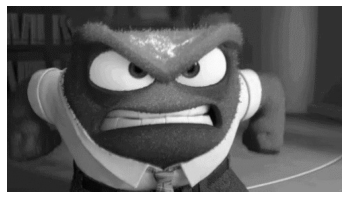

1


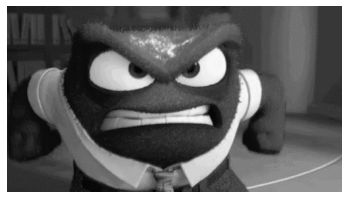

1bis


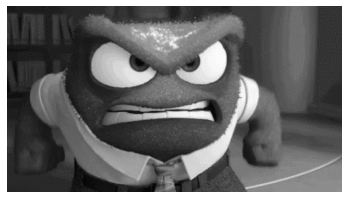

2


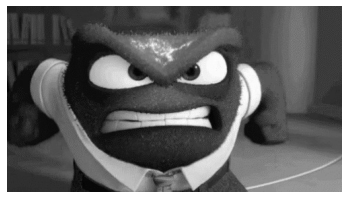

2bis


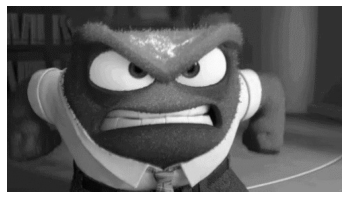

3


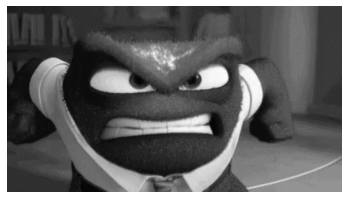

3bis


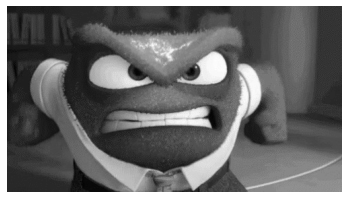

4


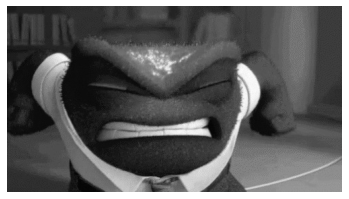

4bis


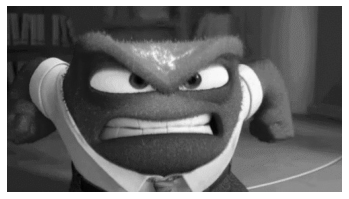

5


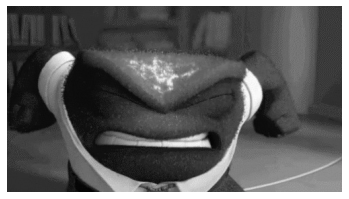

5bis


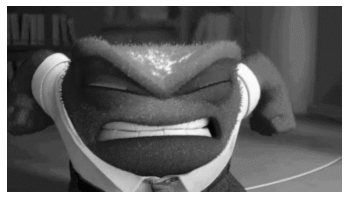

6


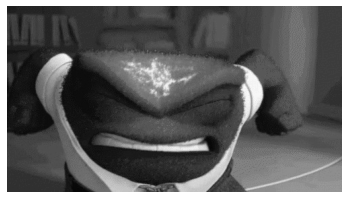

6bis


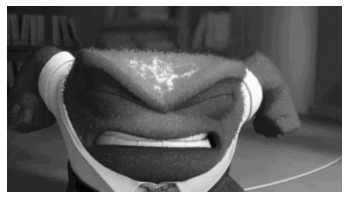

7


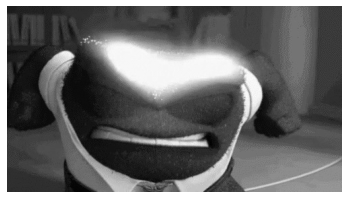

7bis


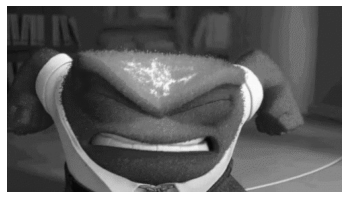

8


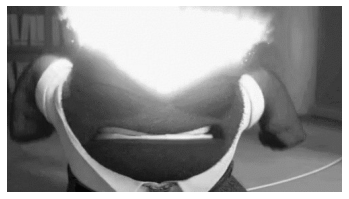

8bis


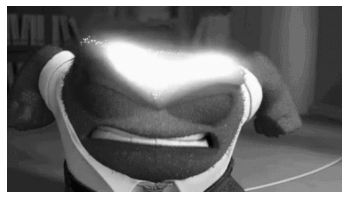

9


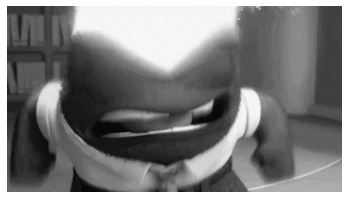

9bis


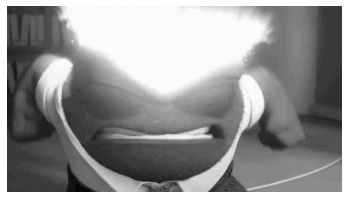

10


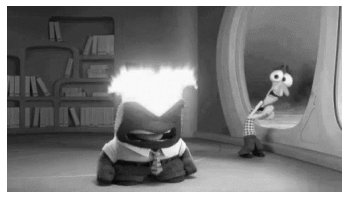

10bis


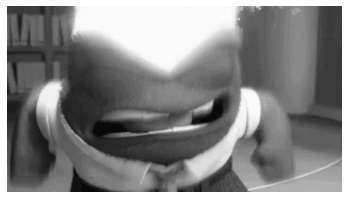

11


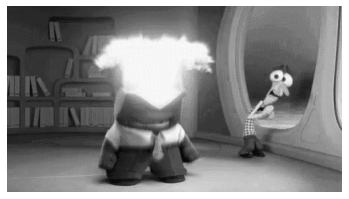

11bis


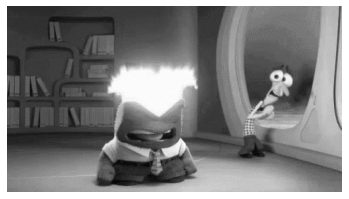

12


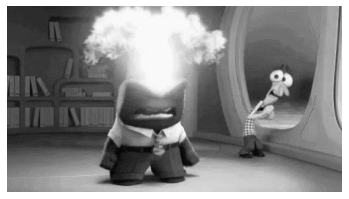

12bis


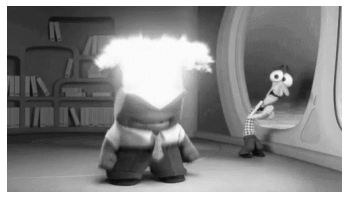

13


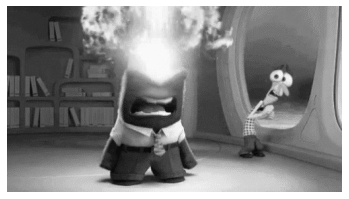

13bis


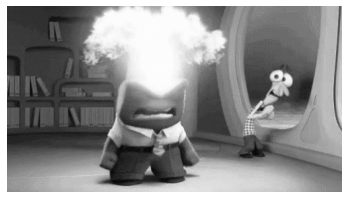

14


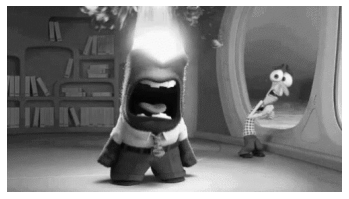

14bis


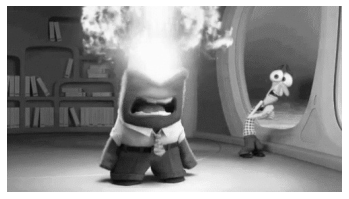

15


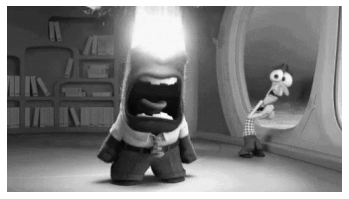

15bis


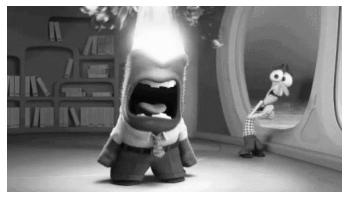

16


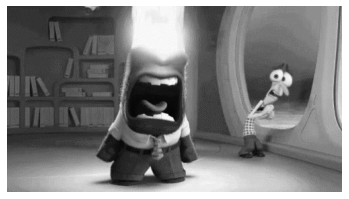

16bis


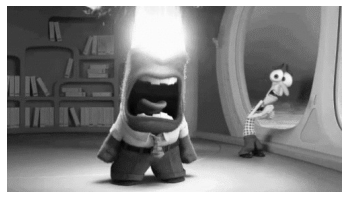

17


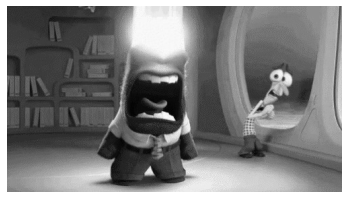

17bis


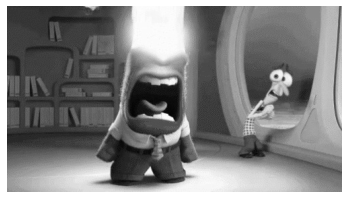

18


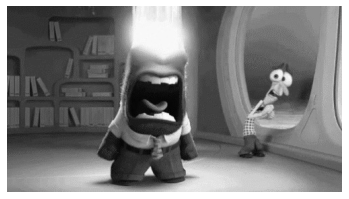

18bis


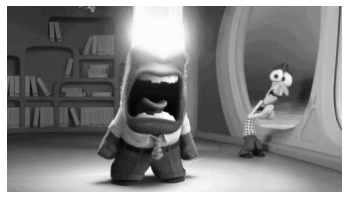

19


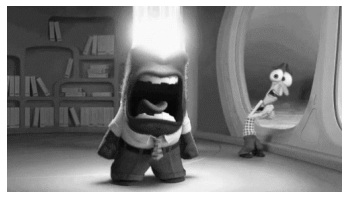

19bis


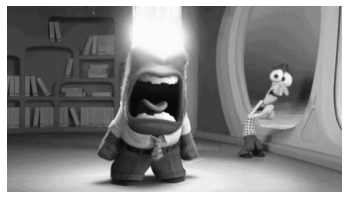

20


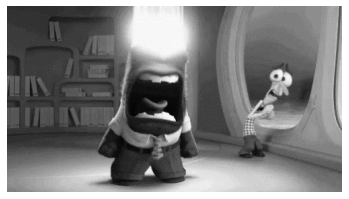

20bis


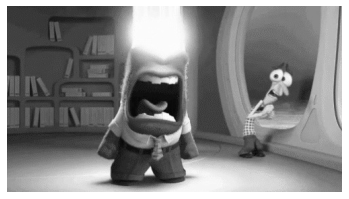

21


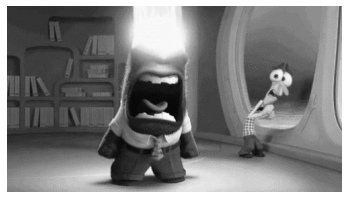

21bis


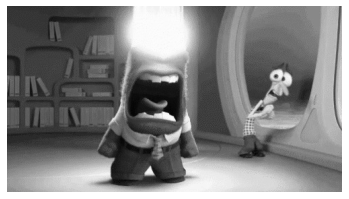

22


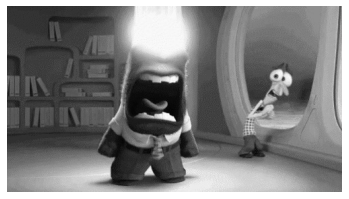

22bis


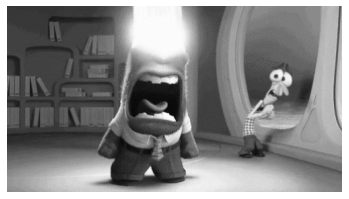

23


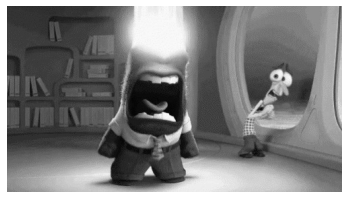

23bis


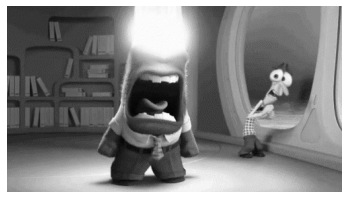

In [33]:
fotogramas = []
for i in range(24):
    print(i)
    original = cv2.imread("Anger/{}.jpg".format(i))
    original = cv2.cvtColor(original,cv2.COLOR_RGB2GRAY) 
    plt.imshow(original, cmap = "binary_r") 
    plt.axis('off') 
    plt.show()
    original = Image.fromarray(original)
    original = original.convert("P")
    fotogramas.append(original)
    print(str(i)+'bis')
    copia = resultados[i]
    plt.imshow(copia, cmap ='binary_r')
    plt.axis('off')
    plt.show()
    copia = Image.fromarray(copia)
    copia = copia.convert("P")
    fotogramas.append(copia)

Creamos un archivo GIF con los fotogramas y lo reproducimos.

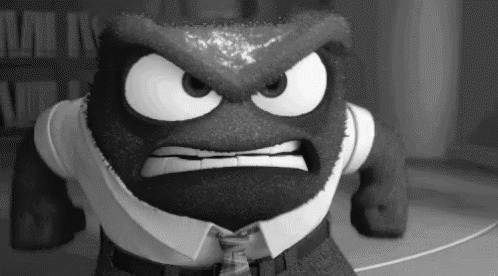

In [34]:
fotogramas[0].save('C:/Users/ALCEA/1_DTSC/_Proyectos/LA PIEZA QUE FALTA/Anger II.gif',
               save_all=True, append_images=fotogramas[1:], optimize=False, duration=40, loop=0)
Imag(filename='C:/Users/ALCEA/1_DTSC/_Proyectos/LA PIEZA QUE FALTA/Anger II.gif')

Como vemos, el movimiento del archivo resultante no es muy fluido: esto se debe a que, como hemos señalado antes, las imágenes predichas por el modelo se asemejan más al fotograma previo al fotograma objetivo que a este último. En consecuencia, vamos a situar cada predicción delante del fotograma objetivo, para ver si de este modo mejora nuestro GIF.    

In [5]:
fotogramas = []
for i in range(24):
    #print(str(i)+'bis')
    copia = resultados[i]
    #plt.imshow(copia, cmap ='binary_r')
    #plt.axis('off')
    #plt.show()
    copia = Image.fromarray(copia)
    copia = copia.convert("P")
    fotogramas.append(copia)
    #print(i)
    original = cv2.imread("Anger/{}.jpg".format(i))
    original = cv2.cvtColor(original,cv2.COLOR_RGB2GRAY) 
    #plt.imshow(original, cmap = "binary_r") 
    #plt.axis('off') 
    #plt.show()
    original = Image.fromarray(original)
    original = original.convert("P")
    fotogramas.append(original)

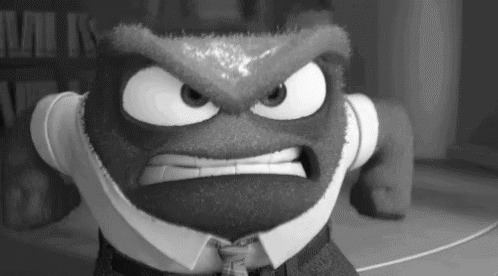

In [6]:
fotogramas[0].save('C:/Users/ALCEA/1_DTSC/_Proyectos/LA PIEZA QUE FALTA/Anger III.gif',
               save_all=True, append_images=fotogramas[1:], optimize=False, duration=40, loop=0)
Imag(filename='C:/Users/ALCEA/1_DTSC/_Proyectos/LA PIEZA QUE FALTA/Anger III.gif')

Efectivamente, el cambio en el orden al intercalar los fotogramas ha mejorado el GIF. La imagen parpadea ligeramente porque las tonalidades de los grises de los fotogramas originales y los fotogramas generados por el modelo no coinciden de manera exacta, pero el resultado es bastante bueno. En conclusión, tal vez sea difícil determinar si, con este ejercicio, hemos dotado el GIF de mayor definición, pero lo que sí parece evidente es que las predicciones del algoritmo serían lo suficientemente buenas como para terminar de manera satisfactoria ese puzle incompleto que tenemos olvidado en algún armario de casa.     